# Exercises and Homework for week 8

## physics718: Programming in Physics and Astronomy with C++ or Python (SS 2022)
Oliver But, Thomas Erben & Matthias Schott 

Homework is due on **Wednesday, 04/06/2022, 23:59pm**

 * You only learn a programming language by actively praticing and using it! We therefore **strongly** advise you to work on the homework problems.
 * Please discuss the problems with your student peers and with your tutor.
 * Your code(s) need(s) to be well and appropriately commented!
 * Submit this notebook and, if necessary, additional files in a `tar`-archive with name `Homework_6_group_XX.tgz` (replace `XX` with your group number) to your tutor.

**Topics of this exercise:**
 * Fast Fourier Transform

**Your group number here please:**  Group 06-02

# 1. Lecture Review (0 points)

If you did the lecture review questions [04_Lecture_Review.ipynb](04_Lecture_Review.ipynb) (strongly recommended!): 
Please discuss with your tutor and your group any issues/problems you had with them.

# 2. Some Basic Consideration (6 points)

In this exercise, you will: Generate a signal composed of a low-frequency sine wave, a high-frequency sine wave (4 times the amplitude of the low frequency),  medium-frequency cosine wave with an amplitude between the other two. Then you will visualize the signal in the time domain and compute and visualize the FFT of the signal (Analyze the real part, imaginary part, magnitude, and phase of the FFT). This is followed by an investigation of the effect of sampling size by doubling and then increasing it tenfold. In the last step, you will need to apply a low-pass filter to the FFT and reconstruct the filtered signal using the inverse FFT. Lets go step by step:

**Sub-Task 1: Generating the Signal**
- Define the sampling rate (fs) and duration.
- Generate a time vector t.
- Create:
    - A low-frequency sine wave (e.g., 5 Hz, amplitude 1),
    - A high-frequency sine wave (20 Hz, amplitude 0.5),
    - A medium-frequency cosine wave (10 Hz, amplitude 0.75).
    - Combine them into one signal.
- Plot the generated signal vs. time.

**Sub-Task 2: FFT Analysis**
- Compute the FFT of the signal.
- Compute the frequency bins.
- Plot:
    - Real part vs. frequency.
    - Imaginary part vs. frequency.
    - Magnitude spectrum (absolute value).
    - Phase spectrum (angle).
    - Interpret what you see as comments in your code
- Repeat the analysis with double and ten times the original sampling size.
    - Discuss what changes in the spectra you see

**Sub-Task 3: Low-Pass Filter**
- Create a simple low-pass filter (e.g., zero out frequency components above a threshold of 12 Hz).
- Apply it to the FFT.
- Perform an inverse FFT to reconstruct the filtered signal.
- Plot the filtered signal vs. time.

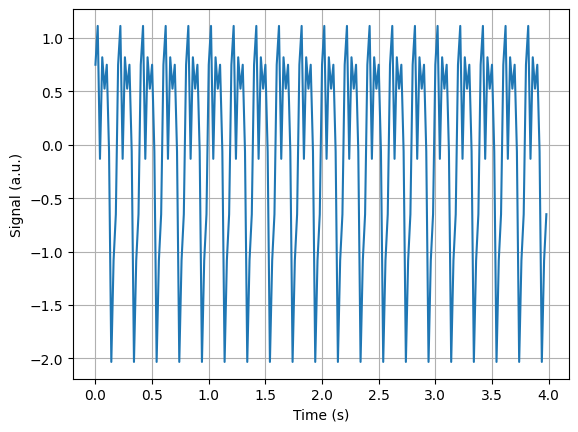

In [1]:
# Your solution for subtask (1) here please
import numpy as np
import matplotlib.pyplot as plt

sampling_rate = 50
duration = 4.0

sample_number = np.arange(0, duration * sampling_rate)

t = np.linspace(0, duration - 1/sampling_rate, int(sampling_rate*duration))


lo_signal = np.sin(5*t * 2*np.pi)
hi_signal = 0.5 * np.sin(20*t * 2*np.pi)
mid_signal = 0.75 * np.cos(10*t * 2*np.pi)

signal = lo_signal + hi_signal + mid_signal

plt.plot(t, signal)

plt.xlabel('Time (s)')
plt.ylabel('Signal (a.u.)')

plt.grid()

plt.show()

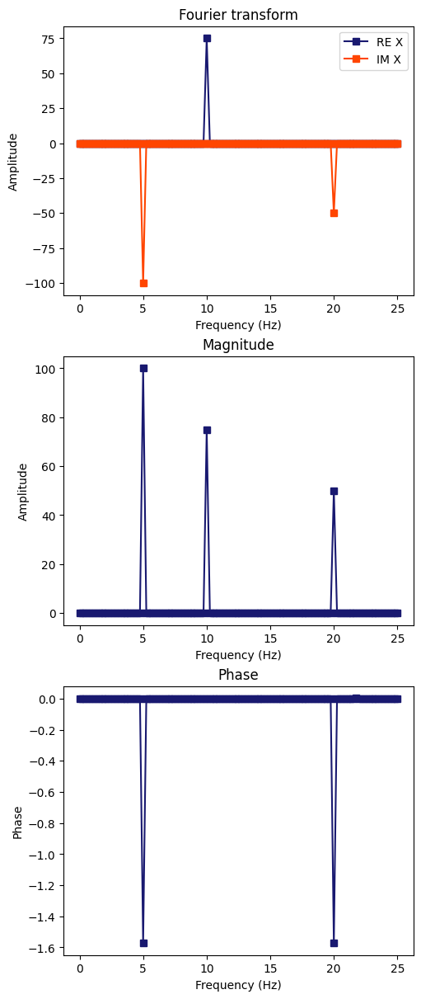

In [2]:
# Your solution for subtask (2) here please

frequencies = np.linspace(0, 1/(t[1]-t[0])/2, int(len(t)/2+1))  # Midpoints of frequency bins

ft = np.fft.rfft(signal)  # Computes the Fourier transform of the signal

fig, ax = plt.subplots(3,1, figsize=(5,12), layout='constrained')

# Plot real and imaginary parts of FT:
ax[0].plot(frequencies,np.real(ft),'s-', label='RE X', color = 'midnightblue')
ax[0].plot(frequencies,np.imag(ft),'s-', label='IM X', color = 'orangered')

ax[0].title.set_text('Fourier transform')
ax[0].set_xlabel('Frequency (Hz)')
ax[0].set_ylabel('Amplitude')
ax[0].legend()

# Plot modulus of FT:
ax[1].plot(frequencies,np.abs(ft),'s-',color = 'midnightblue')

ax[1].title.set_text('Magnitude')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].set_ylabel('Amplitude')

# Plot phase of FT:
ax[2].plot(frequencies,np.arctan(np.imag(ft)/(np.real(ft)+1e-10)),'s-',color = 'midnightblue')

ax[2].title.set_text('Phase')
ax[2].set_xlabel('Frequency (Hz)')
ax[2].set_ylabel('Phase')


plt.show()


In [3]:
def generate_signal_and_fft (duration, sample_rate):
    N = int(duration * sample_rate)

    t = np.linspace(0, duration - 1/sampling_rate, N)

    frequencies = np.linspace(0, 1/(t[1]-t[0])/2, int(len(t)/2+1))
    
    lo_signal = np.sin(5*t * 2*np.pi)
    hi_signal = 0.5 * np.sin(20*t * 2*np.pi)
    mid_signal = 0.75 * np.cos(10*t * 2*np.pi)

    signal = lo_signal + hi_signal + mid_signal

    ft = np.fft.rfft(signal)

    return t, frequencies, signal, ft

NN = [2, 10]

ft_list = [(t, frequencies, signal, ft)]

ft_list += [generate_signal_and_fft(k * duration, sampling_rate) for k in NN]


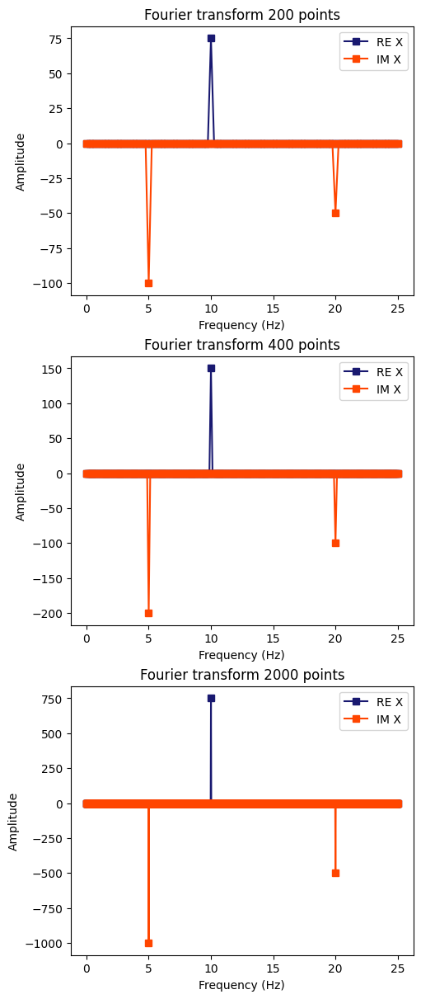

In [4]:
fig, ax = plt.subplots(3,1, figsize=(5,12), layout='constrained')

for i, tup in enumerate(ft_list):
    T, freqs, ssignal, FT = tup

    ax[i].plot(freqs,np.real(FT),'s-', label='RE X', color = 'midnightblue')
    ax[i].plot(freqs,np.imag(FT),'s-', label='IM X', color = 'orangered')

    ax[i].title.set_text('Fourier transform {} points'.format(len(T)))
    ax[i].set_xlabel('Frequency (Hz)')
    ax[i].set_ylabel('Amplitude')
    ax[i].legend()


plt.show()


# We notice that the frequency peaks become sharper as the sampling size increases.

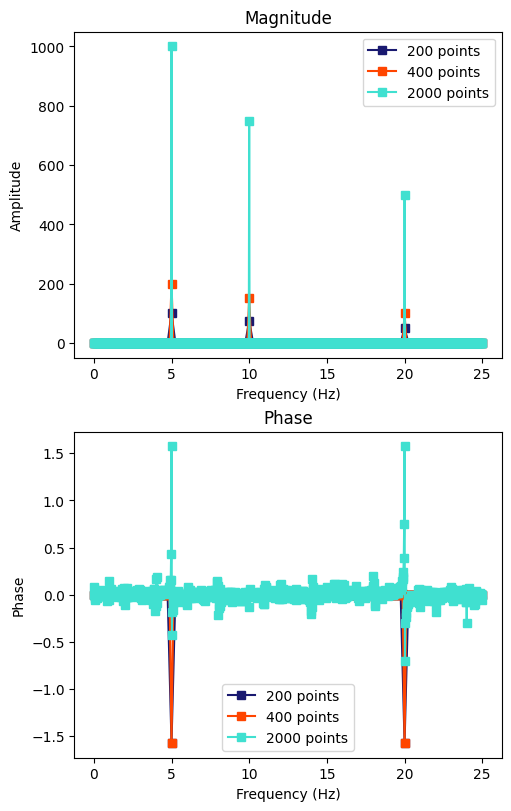

In [5]:
colors = ['midnightblue', 'orangered', 'turquoise']

fig, ax = plt.subplots(2,1, figsize=(5,8), layout='constrained')

for i, tup in enumerate(ft_list):
    T, freqs, ssignal, FT = tup
    label = '{} points'.format(len(T))
    ax[0].plot(freqs, np.abs(FT), 's-', color=colors[i], label=label)
    ax[1].plot(freqs, np.arctan(np.imag(FT)/(np.real(FT)+1e-10)), 's-', color=colors[i], label=label)


ax[0].title.set_text('Magnitude')
ax[0].set_xlabel('Frequency (Hz)')
ax[0].set_ylabel('Amplitude')
ax[0].legend()

ax[1].title.set_text('Phase')
ax[1].set_xlabel('Frequency (Hz)')
ax[1].set_ylabel('Phase')
ax[1].legend()

plt.show()

# The phase appears to become noisier as the sampling number increases

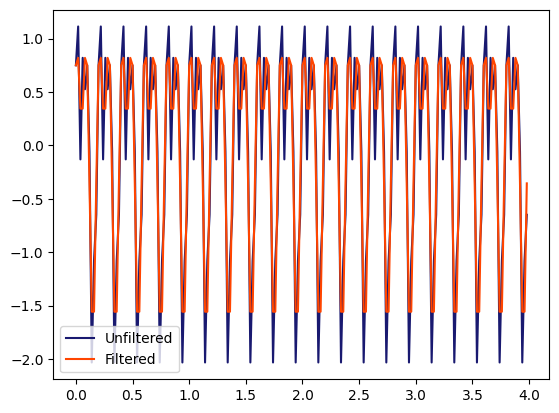

In [6]:
# Your solution for subtask (3) here please

mask = frequencies > 12

ft_filter = np.copy(ft)
ft_filter[mask] = 0

filtered = np.fft.irfft(ft_filter)

plt.plot(t, signal, color=colors[0], label = 'Unfiltered')
plt.plot(t, filtered, color=colors[1], label = 'Filtered')

plt.legend()

plt.show()

## 3. Moon-Landing (7 points)

In this exercise, you will implement image denoising using the 2D Fast Fourier Transform (FFT). You will load a grayscale image, analyze its frequency spectrum, apply a frequency-based filter to remove high-frequency noise, and reconstruct the denoised image.

Your task is to start by loading the image moonlanding.png using plt.imread(). Convert the image to a floating-point array and extract the first channel if the image has multiple color channels, to ensure the data is two-dimensional. Display the shape of the image to confirm it.

<img src="data/moonlanding.png" style="width: 500px;" style="height: 250px;">


Next, compute the 2D Fourier Transform of the image using np.fft.fft2(). Store the result in a variable F, which represents the frequency spectrum of the image. To visualize this spectrum, write a function plot_spectrum(F) that computes the magnitude of F, scales it for better display, and clips values above a certain threshold. Use plt.imshow() to display the scaled magnitude spectrum.

Make a copy of F named ff. You will apply a simple frequency filter by zeroing out high-frequency components, by zeroing out rows and columns. You need to play around which rows and columns to be zeroed out to achieve an optimal result, i.e. a image where the high-frequency components are removed from the spectrum.

Reconstruct the denoised image by applying the inverse FFT using np.fft.ifft2(ff), and extract the real part of the result. Store the reconstructed image as im_new.

Finally, display the original image, the original Fourier spectrum, the filtered spectrum, and the reconstructed denoised image using plt.imshow() in a subplot grid.

(474, 630)


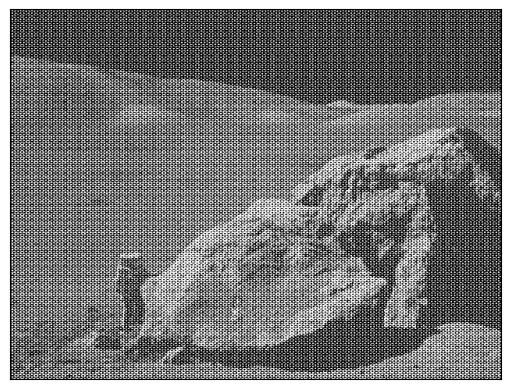

In [7]:
# Your solution here please

image = plt.imread('data/moonlanding.png')

print(image.shape)  # Image shape is 2-dimensional

plt.imshow(image, cmap='gray')
plt.tick_params(bottom=False, left=False, labelleft=False, labelbottom=False)

plt.show()

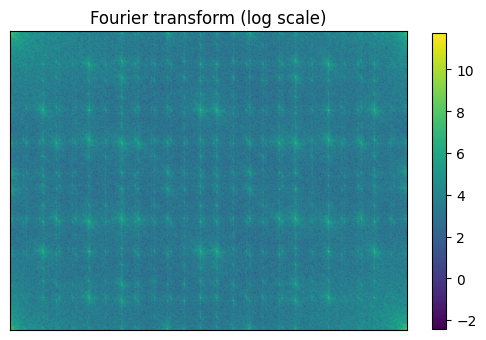

In [8]:
F = np.fft.fft2(image)

def plot_spectrum(fft):
    
    scaled_fft = np.log(np.abs(fft))

    plt.imshow(scaled_fft)
    plt.tick_params(bottom=False, left=False, labelleft=False, labelbottom=False)
    plt.colorbar(shrink=0.8)
    return None

plot_spectrum(F)
plt.title('Fourier transform (log scale)')
plt.show()

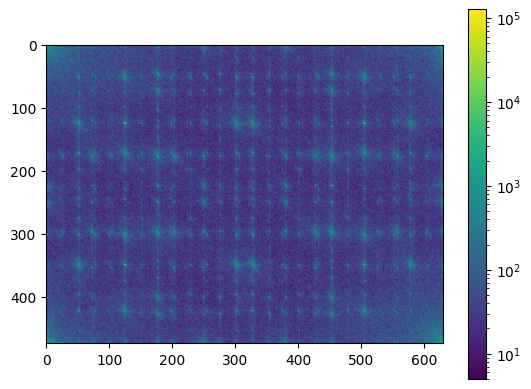

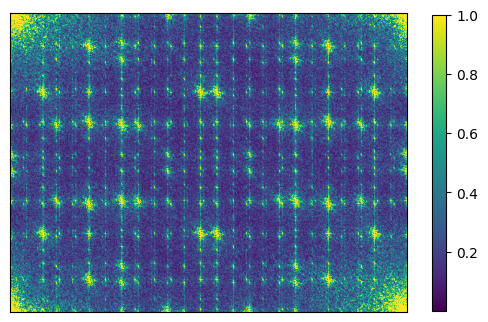

In [9]:
# Alternative visualizations of the spectrum

from matplotlib.colors import LogNorm

plt.imshow(np.abs(F), norm=LogNorm(vmin=5))
plt.colorbar()

plt.show()

mask = np.abs(F) > 150

cut = np.max(np.abs(F)[np.logical_not(mask)])

F_cut = np.copy(F)
F_cut[mask] = cut

normalized = np.abs(F_cut)/np.max(np.abs(F_cut))

plt.imshow(normalized)
plt.tick_params(bottom=False, left=False, labelleft=False, labelbottom=False)
plt.colorbar(shrink=0.8)

plt.show()

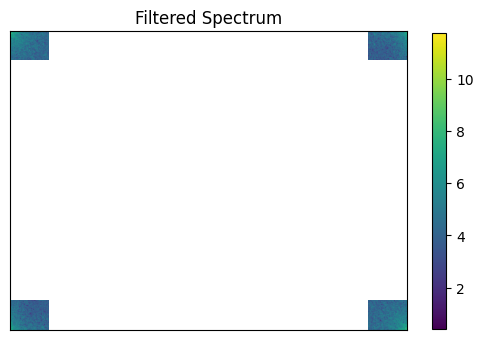

In [10]:
# The unexpected portion of the spectrum is the grid in the middle of the image.
# We will therefore zero everything out except for the corners.
# To do so we define a parameter determining the size of the corner we're preserving.
corner_size= 0.1

ff = np.copy(F)  # Make a copy of Fourier transform

# Set r and c to be the number of rows and columns of the FT
r, c = ff.shape

ff[int(r*corner_size):int(r*(1-corner_size))] = 0  # Zero out rows not in corner

ff[:, int(c*corner_size):int(c*(1-corner_size))] = 0 # Zero out columns not in corner

# Since our plot_spectrum function take the logarithm of the value, we change all zeroes for NaN
# in order to plot the new spectrum.
mask = (ff == 0)

display_ff = np.copy(ff)
display_ff[mask] = np.nan

plt.figure()
plot_spectrum(display_ff)
plt.title('Filtered Spectrum')

plt.show()

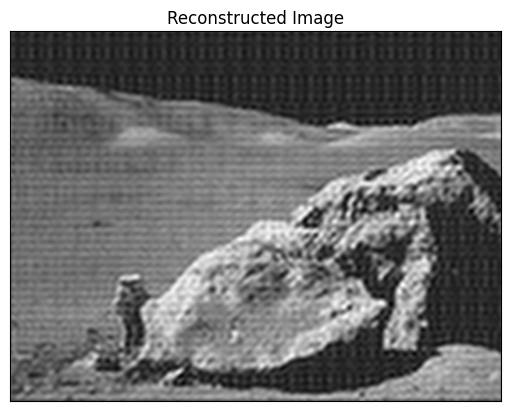

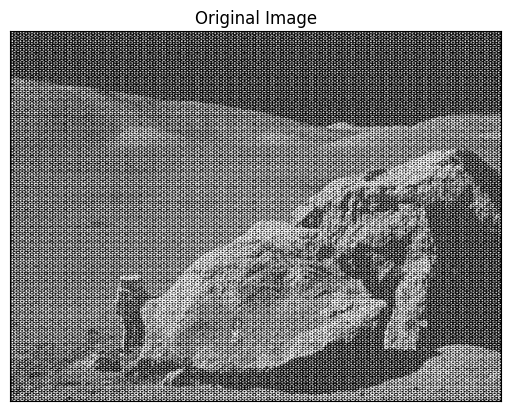

In [11]:
im_new = np.fft.ifft2(ff)

plt.imshow(np.real(im_new), cmap='gray')
plt.tick_params(bottom=False, left=False, labelleft=False, labelbottom=False)
plt.title('Reconstructed Image')

plt.show()

plt.imshow(image, cmap='gray')
plt.tick_params(bottom=False, left=False, labelleft=False, labelbottom=False)
plt.title('Original Image')

plt.show()

## 4. Audio Analysis and Processing (7 points)

We just received an audio recording from famous composer Kevin MacLeod, but it seems like the recording contains some unwanted high frequency noise! So in this exercise, we are going to analyse the frequency spectrum of a waveform and remove the noisy component using the Fourier transform. To test our techniques, we will showcase the procedure for a simpler test file first.

In [12]:
from IPython.display import Audio
Audio("data/sneaky_snitch_noisy.wav")

In [13]:
Audio("data/simple.wav")

The steps are:
1. Load the audio file `data/simple.wav' and plot the waveform and the frequency spectrum using Fourier transformations. 
2. Identify the dominating frequencies and the region of noise. Then remove the unwanted noise in the frequency domain.
3. Transform the sample back into the time domain and save the file as an `.wav`. Describe the effect of your filtering scheme on the resulting sound.
4. Repeat steps 1 to 3 with `data/sneaky_snitch_noisy.wav` to get a file `sneaky_snitch_denoised.wav`.

Hints:
- You can use the `pydub` library to load the `.wav` files
- You can use `scipy.io.wavfile` to write `.wav` files

In [14]:
# Your solution here please
from pydub import AudioSegment

clip1 = AudioSegment.from_file('data/sneaky_snitch_noisy.wav')
clip2 = AudioSegment.from_file('data/simple.wav')

samples1 = np.array(clip1.get_array_of_samples())
samples2 = np.array(clip2.get_array_of_samples())

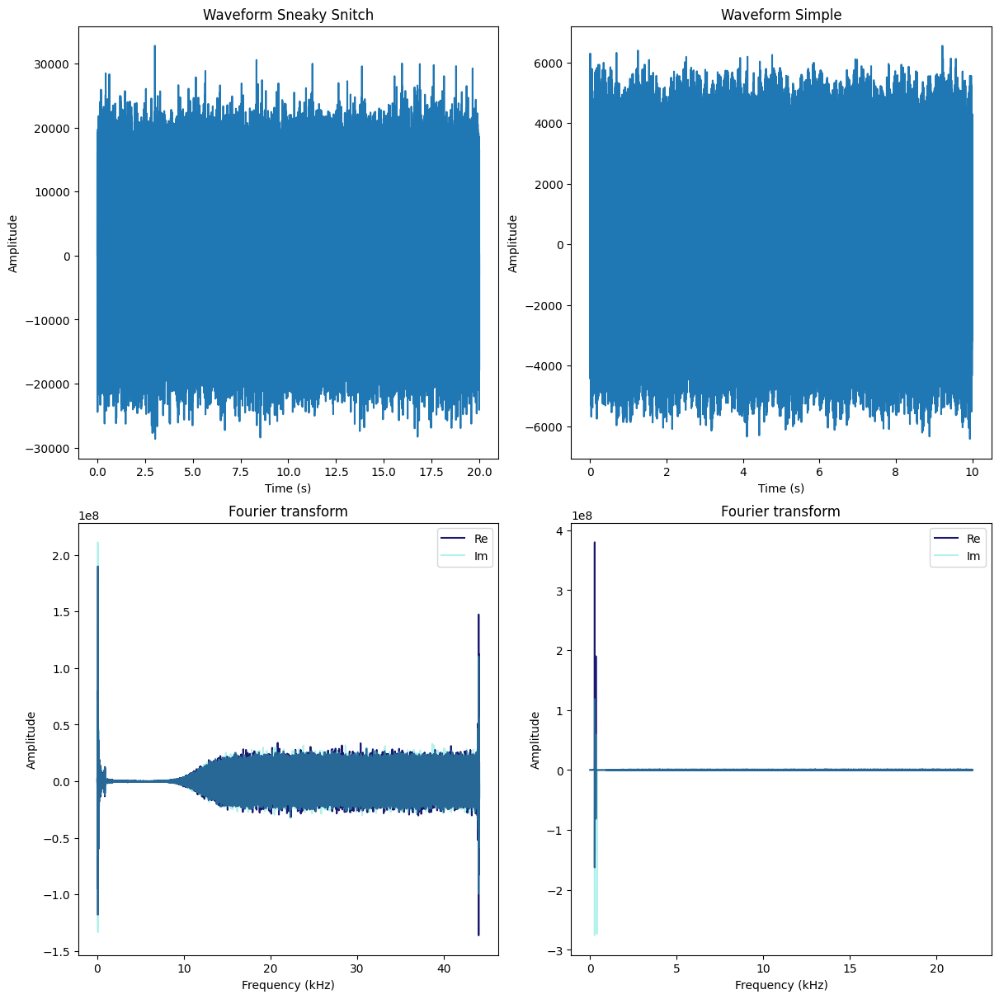

In [15]:
fig, ax = plt.subplots(2, 2, figsize=(12,12), layout='constrained')


t1 = np.linspace(0, 20, samples1.size)

ax[0,0].plot(t1, samples1)

ax[0,0].set_xlabel('Time (s)')
ax[0,0].set_ylabel('Amplitude')
ax[0,0].set_title('Waveform Sneaky Snitch')

t2 = np.linspace(0, 10, samples2.size)

ax[0,1].plot(t2, samples2)

ax[0,1].set_xlabel('Time (s)')
ax[0,1].set_ylabel('Amplitude')
ax[0,1].set_title('Waveform Simple')

freqs1 = np.linspace(0, 1/(t1[1]-t1[0])/2, int(len(t1)/2+1))
ft1 = np.fft.rfft(samples1)

ax[1,0].plot(freqs1/1.e+3, np.real(ft1), color = 'midnightblue', label='Re')
ax[1,0].plot(freqs1/1.e+3, np.imag(ft1), color = 'turquoise', label='Im', alpha=0.4)

ax[1,0].set_xlabel('Frequency (kHz)')
ax[1,0].set_ylabel('Amplitude')
ax[1,0].set_title('Fourier transform')
ax[1,0].legend()


freqs2 = np.linspace(0, 1/(t2[1]-t2[0])/2, int(len(t2)/2+1))
ft2 = np.fft.rfft(samples2)

ax[1,1].plot(freqs2/1.e+3, np.real(ft2), color = 'midnightblue', label='Re')
ax[1,1].plot(freqs2/1.e+3, np.imag(ft2), color = 'turquoise', label='Im', alpha=0.4)

ax[1,1].set_xlabel('Frequency (kHz)')
ax[1,1].set_ylabel('Amplitude')
ax[1,1].set_title('Fourier transform')
ax[1,1].legend()


plt.show()

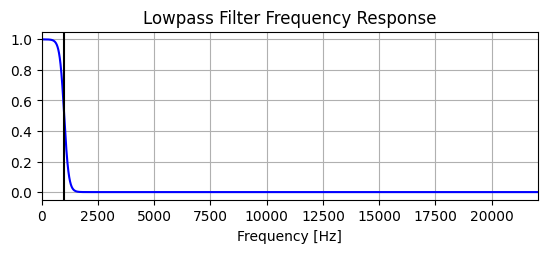

In [16]:
lowPass = 1/(1 + np.exp((freqs2 - 1000)*1.0e-2))

plt.subplot(2, 1, 1)
plt.plot(freqs2, lowPass, 'b')
plt.axvline(1000, color='k')
plt.xlim(0, 0.5*clip2.frame_rate)
plt.title("Lowpass Filter Frequency Response")
plt.xlabel('Frequency [Hz]')
plt.grid()

plt.show()

ft_filter = np.copy(ft2)

ft_filter *= lowPass

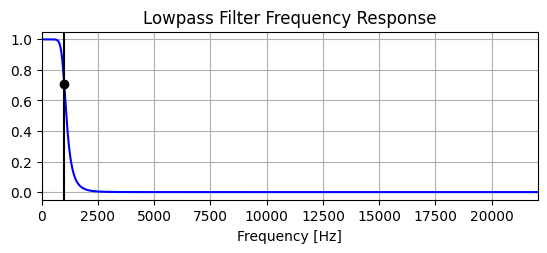

In [17]:
from scipy.signal import butter, lfilter, freqz


def butter_lowpass(cutoff, fs, order=5):
    return butter(order, cutoff, fs=fs, btype='low', analog=False)

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y


# Filter requirements.
order = 6
fs = clip2.frame_rate       # sample rate, Hz
cutoff = 1000  # desired cutoff frequency of the filter, Hz

# Get the filter coefficients so we can check its frequency response.
b, a = butter_lowpass(cutoff, fs, order)

# Plot the frequency response.
w, h = freqz(b, a, fs=fs, worN=8000)
plt.subplot(2, 1, 1)
plt.plot(w, np.abs(h), 'b')
plt.plot(cutoff, 0.5*np.sqrt(2), 'ko')
plt.axvline(cutoff, color='k')
plt.xlim(0, 0.5*fs)
plt.title("Lowpass Filter Frequency Response")
plt.xlabel('Frequency [Hz]')
plt.grid()

plt.show()

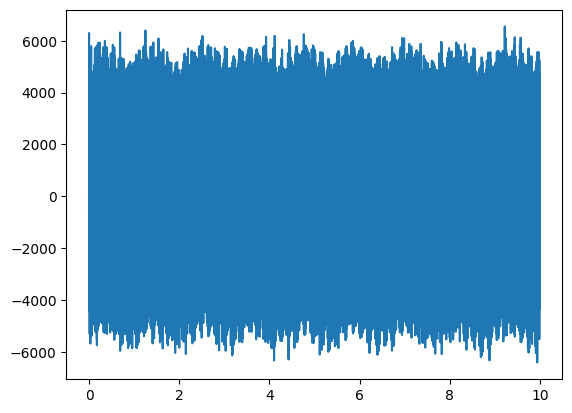

In [22]:
plt.plot(t2, np.fft.irfft(ft2))

plt.show()

In [18]:
from scipy.io.wavfile import write

samples_denoised = np.fft.irfft(ft2)

write('output/simple_denoised.wav', clip2.frame_rate, samples_denoised)

Audio("output/simple_denoised.wav")

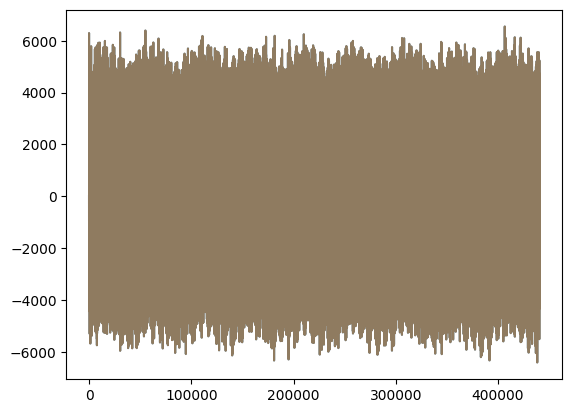

In [35]:
from scipy.io.wavfile import read
clip_data = read('data/simple.wav')

plt.plot(clip_data[1])
plt.plot(samples_denoised, alpha = 0.5)

plt.show()

In [24]:
clip_data[0]

44100

In [39]:
ft = np.fft.rfft(clip_data[1])

samples_denoised = np.fft.irfft(ft)

write('output/simple.wav', clip_data[0], clip_data[1])
write('output/simple_reconstructed.wav', clip_data[0], samples_denoised)

Audio("output/simple_reconstructed.wav")

In [ ]:
pure = np.sin(220 * t2 * 2*np.pi) + np.sin(440 * t2 * 2*np.pi)

write('output/simplest.wav', clip_data[0], pure)

Audio("output/simplest.wav")


In [40]:
Audio("output/simple.wav")